In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle


# Read in an image
image = mpimg.imread('test_images/test5.jpg')

ksize = 15

In [16]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
  # 1) Convert to grayscale
  gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
  # 2) Take the derivative in x or y given orient = 'x' or 'y'
  if orient is 'x':
      sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
  else:
      sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
  # 3) Take the absolute value of the derivative or gradient
  abs_sobel = np.absolute(sobel)
  # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
  scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
  # 5) Create a mask of 1's where the scaled gradient magnitude 
  grad_binary = np.zeros_like(scaled_sobel)
          # is > thresh_min and < thresh_max
  grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
  # 6) Return this mask as your binary_output image
  return grad_binary
def abs_channel_sobel_thresh(img, channel=0, orient='x', sobel_kernel=3, thresh=(0, 255)):
  # 1) Convert to grayscale
  c_img = img[:,:,channel]
  # 2) Take the derivative in x or y given orient = 'x' or 'y'
  if orient is 'x':
      sobel = cv2.Sobel(c_img, cv2.CV_64F, 1, 0)
  else:
      sobel = cv2.Sobel(c_img, cv2.CV_64F, 0, 1)
  # 3) Take the absolute value of the derivative or gradient
  abs_sobel = np.absolute(sobel)
  # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
  scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
  # 5) Create a mask of 1's where the scaled gradient magnitude 
  grad_binary = np.zeros_like(scaled_sobel)
          # is > thresh_min and < thresh_max
  grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
  # 6) Return this mask as your binary_output image
  return grad_binary

def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
  # 1) Convert to grayscale
  gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
  # 2) Take the gradient in x and y separately
  sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
  sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
  # 3) Calculate the magnitude 
  sobel = ((sobelx)**2 + (sobely)**2)**0.5
  # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
  scaled_sobel = np.uint8(255*sobel/np.max(sobel))
  # 5) Create a binary mask where mag thresholds are met
  mag_binary = np.zeros_like(scaled_sobel)
  # 6) Return this mask as your binary_output image
  mag_binary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
  return mag_binary

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
  # 1) Convert to grayscale
  gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
  # 2) Take the gradient in x and y separately
  sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
  sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
  # 3) Take the absolute value of the x and y gradients
  abs_sobelx = np.absolute(sobelx)
  abs_sobely = np.absolute(sobely)
  # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
  arc_tan_sobel = np.arctan2(abs_sobely, abs_sobelx)
  # 5) Create a binary mask where direction thresholds are met
  dir_binary = np.zeros_like(arc_tan_sobel)
  dir_binary[(arc_tan_sobel >= thresh[0]) & (arc_tan_sobel <= thresh[1])] = 1
  # 6) Return this mask as your binary_output image
  return dir_binary
  
def hls_threshold(image, channel='h', thresh=(0, 255)):
  hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS).astype(np.float)
  if channel is 'h':
    c_img = hls[:,:,0]
  elif channel is 'l':
    c_img = hls[:,:,1]
  else:
    c_img = hls[:,:,2]
  
  scaled_img = np.uint8(255*c_img/np.max(c_img))
  binary = np.zeros_like(scaled_img)
  binary[(scaled_img >= thresh[0]) & (scaled_img <= thresh[1])] = 1
  return binary

def hsv_threshold(image, channel='h', thresh=(0, 255)):
  hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
  if channel is 'h':
    c_img = hsv[:,:,0]
  elif channel is 's':
    c_img = hsv[:,:,1]
  else:
    c_img = hsv[:,:,2]

  scaled_img = np.uint8(255*c_img/np.max(c_img))
  binary = np.zeros_like(scaled_img)
  binary[(scaled_img >= thresh[0]) & (scaled_img <= thresh[1])] = 50
  return binary

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


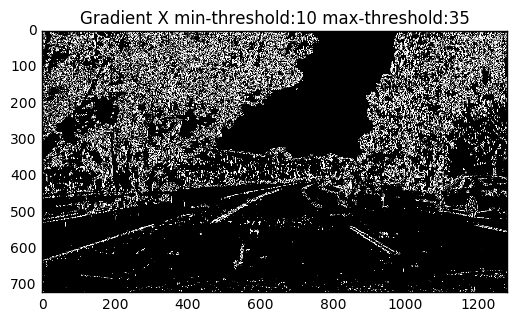

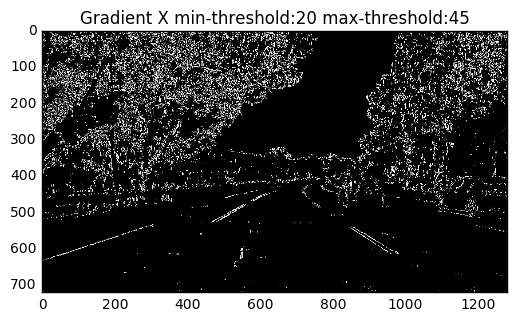

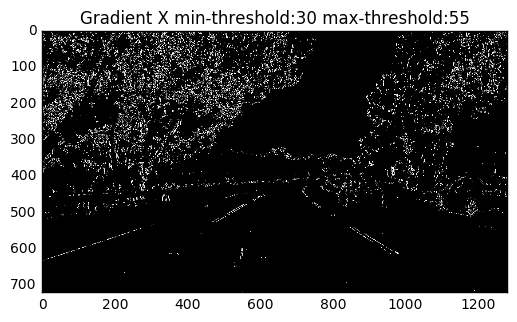

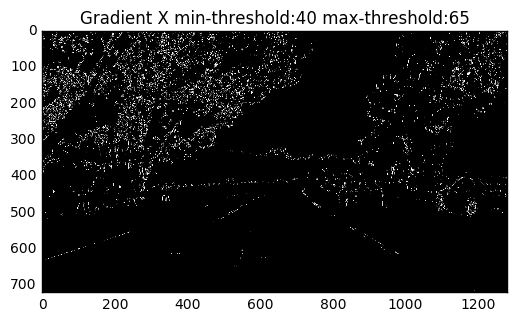

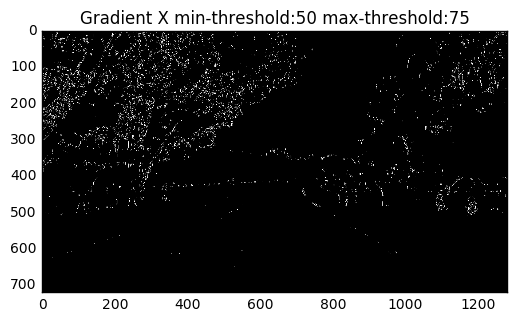

...

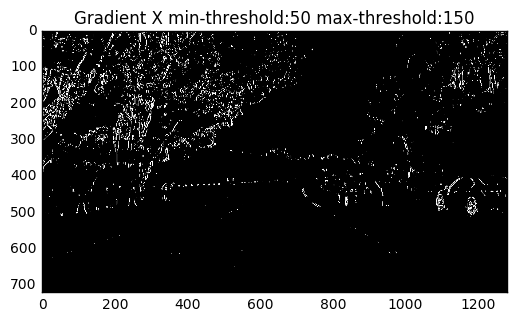

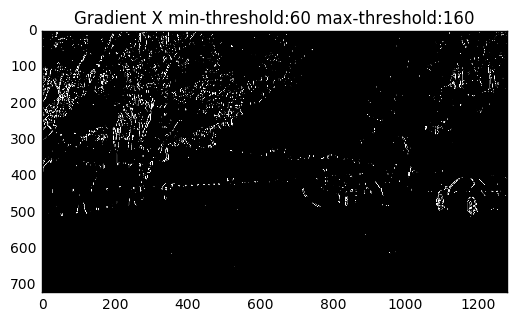

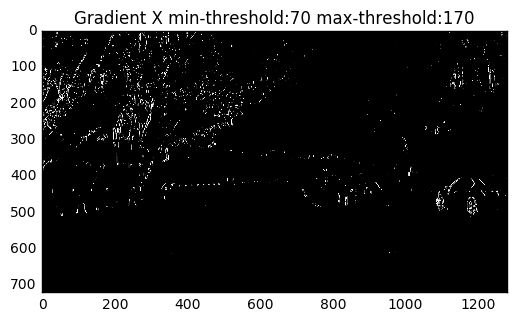

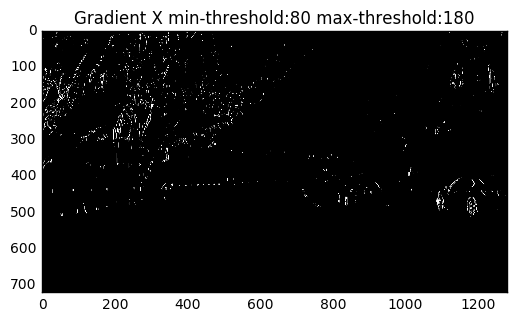

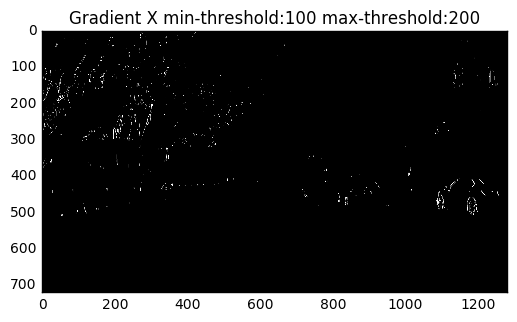

In [3]:
import math
max_val = 255
for gap in [25, 50, 75, 100]:
  for start in [10, 20, 30, 40, 50, 60, 70, 80, 100]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("Gradient X min-threshold:{} max-threshold:{}".format(start, end))
    plt.imshow(abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
    
plt.show()

Best results
- 20 - 95
- 30 - 130

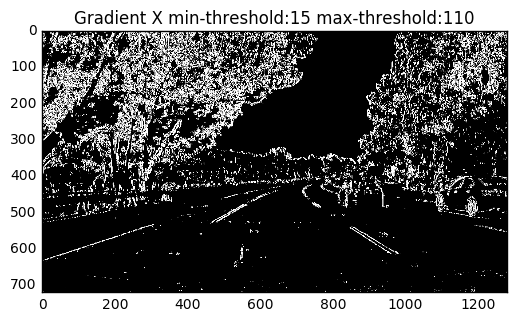

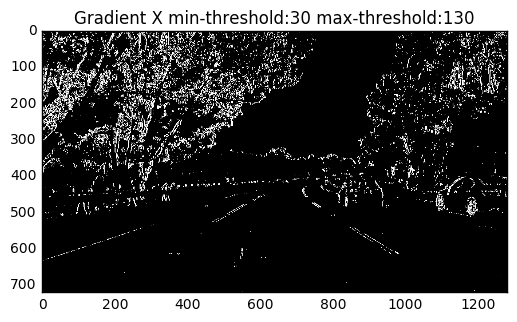

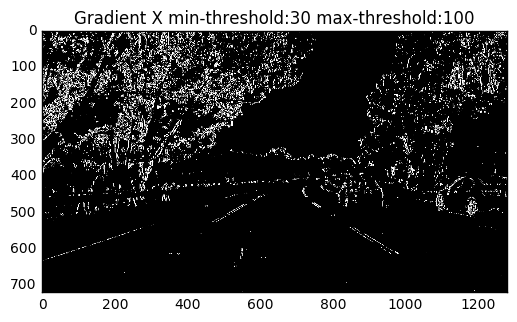

In [4]:
fig = plt.figure()
start = 15
end = 110
plt.title("Gradient X min-threshold:{} max-threshold:{}".format(start, end))
plt.imshow(abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
fig = plt.figure()
start = 30
end = 130
plt.title("Gradient X min-threshold:{} max-threshold:{}".format(start, end))
plt.imshow(abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
plt.show()
fig = plt.figure()
start = 30
end = 100
plt.title("Gradient X min-threshold:{} max-threshold:{}".format(start, end))
plt.imshow(abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
plt.show()
## Best is 30 - 100

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


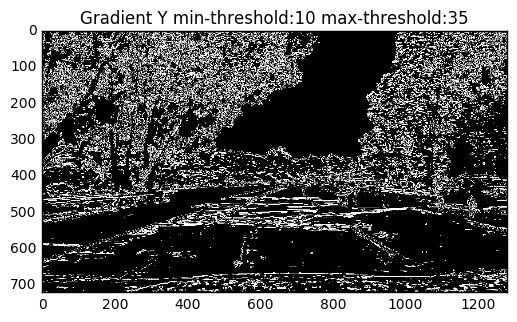

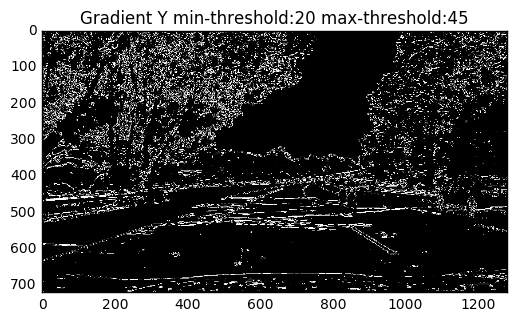

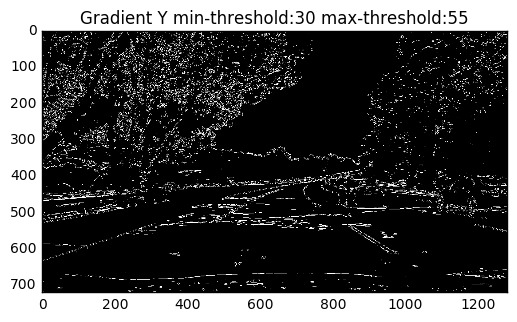

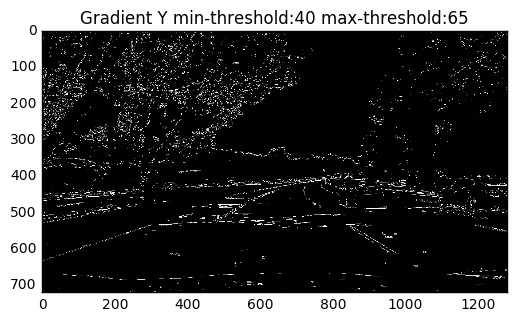

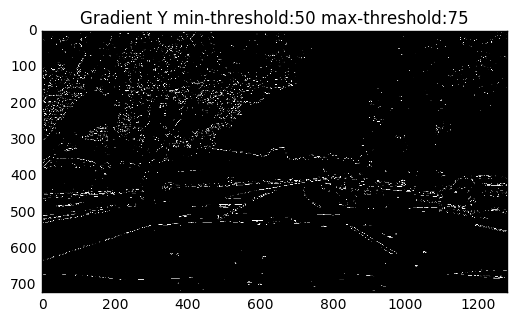

...

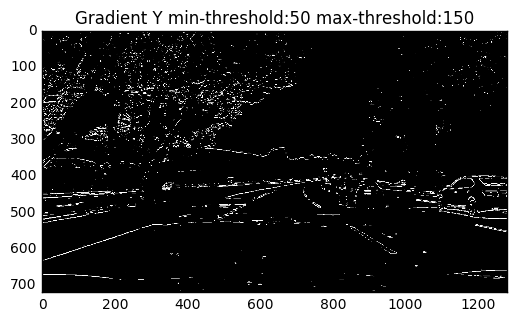

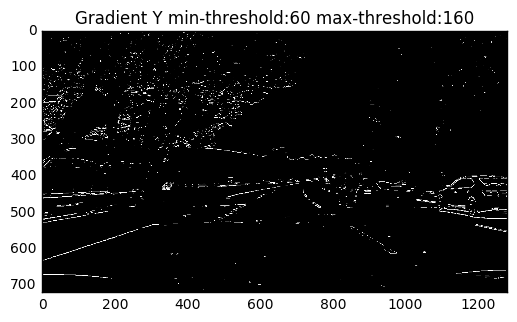

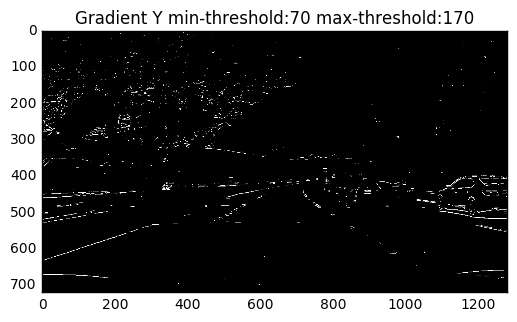

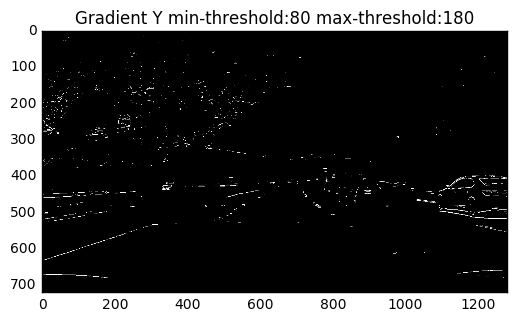

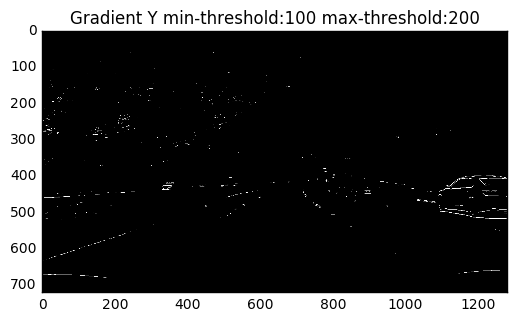

In [5]:
import math
max_val = 255
for gap in [25, 50, 75, 100]:
  for start in [10, 20, 30, 40, 50, 60, 70, 80, 100]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("Gradient Y min-threshold:{} max-threshold:{}".format(start, end))
    plt.imshow(abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
    
plt.show()

Best are:
- 40 - 140

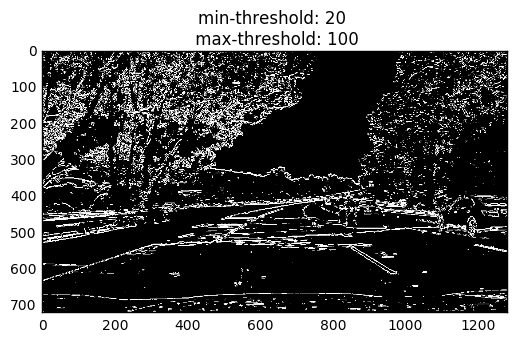

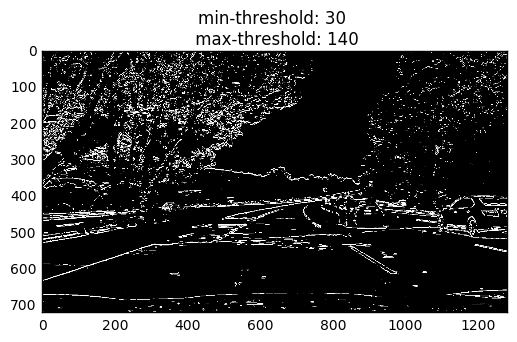

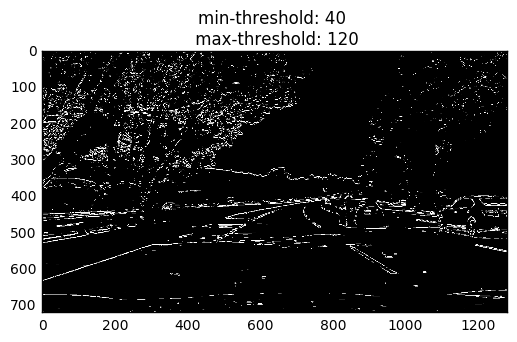

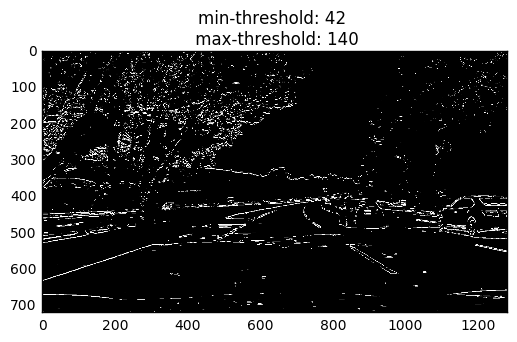

In [6]:
for thresh in [(20, 100), (30, 140), (40, 120), (42, 140)]:
  fig = plt.figure()
  start = thresh[0]
  end = thresh[1]
  plt.title("min-threshold: {} \n max-threshold: {}".format(start, end))
  plt.imshow(abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
plt.show()
# 40 - 140 best

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


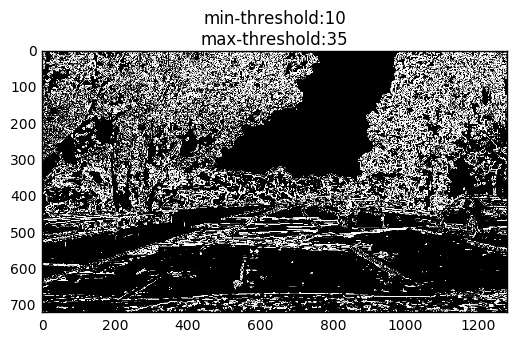

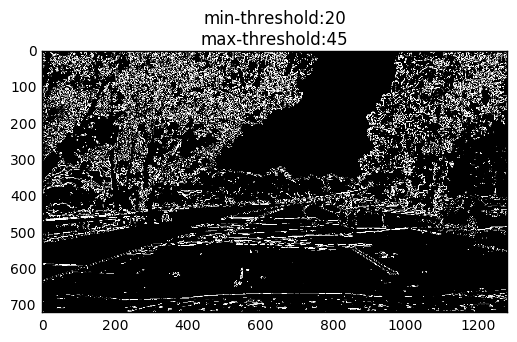

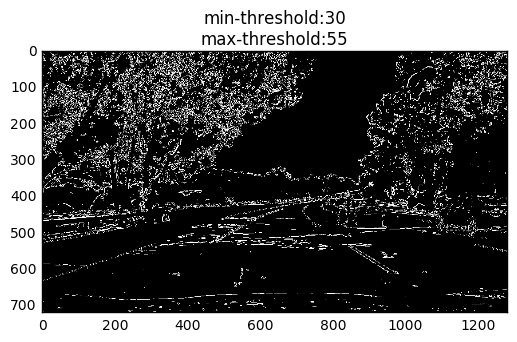

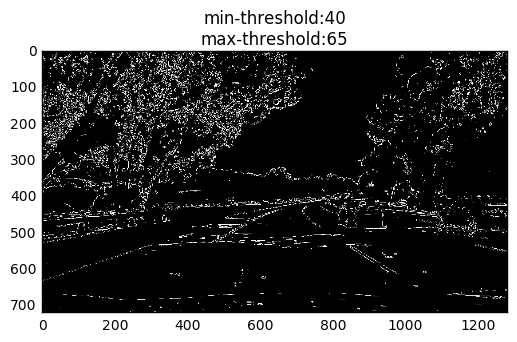

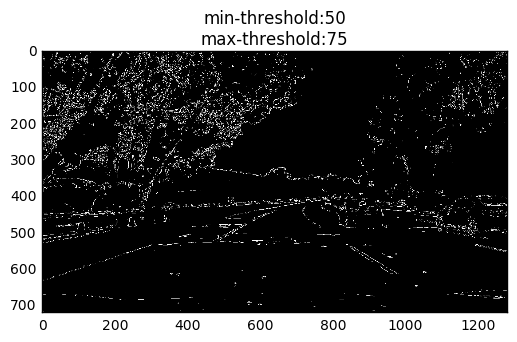

...

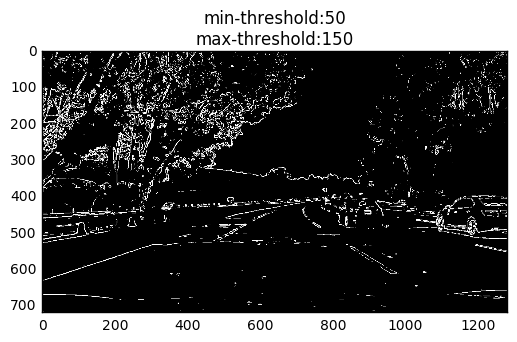

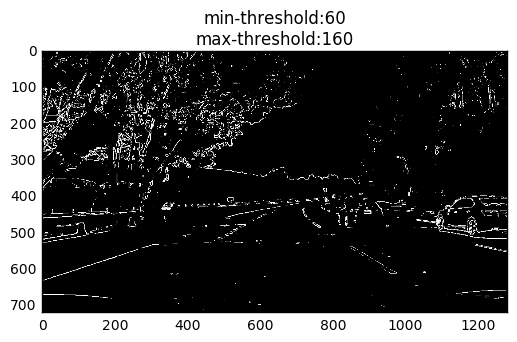

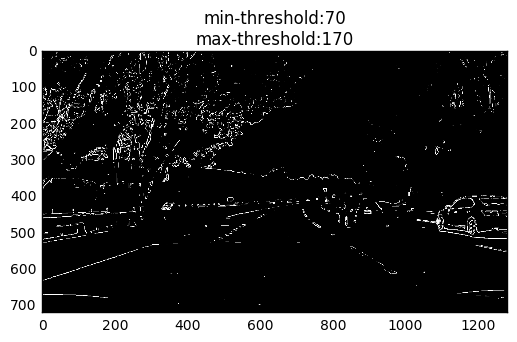

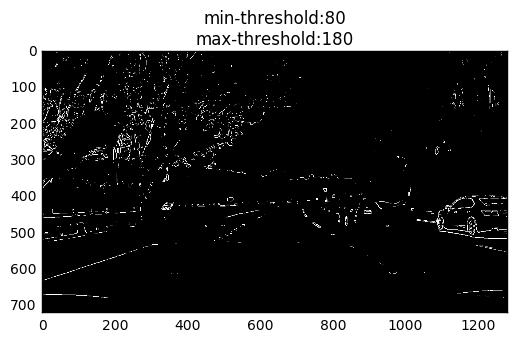

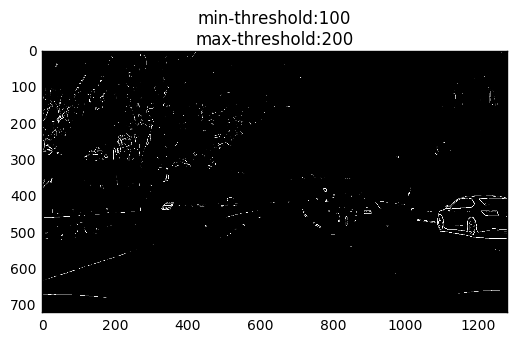

In [7]:

max_val = 255
for gap in [25, 50, 75, 100]:
  for start in [10, 20, 30, 40, 50, 60, 70, 80, 100]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("min-threshold:{}\nmax-threshold:{}".format(start, end))
    plt.imshow(mag_thresh(image, sobel_kernel=ksize, mag_thresh=(start, end)), cmap='gray')
    
plt.show()

Best results:
- 50 - 100
- 30 - 105
- 40 - 140

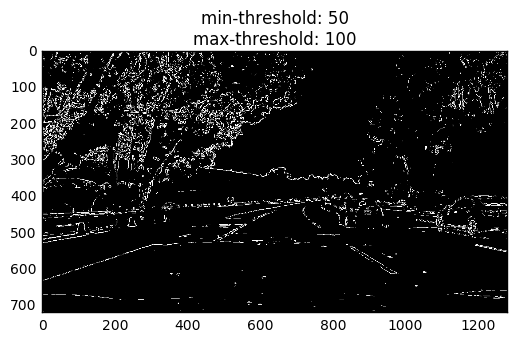

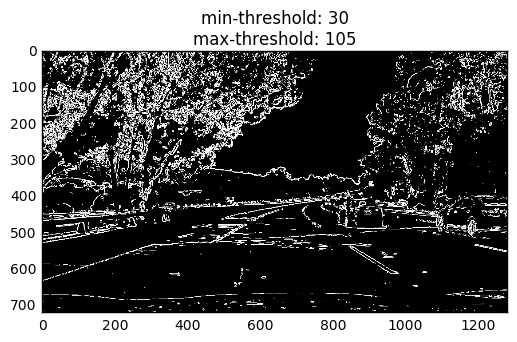

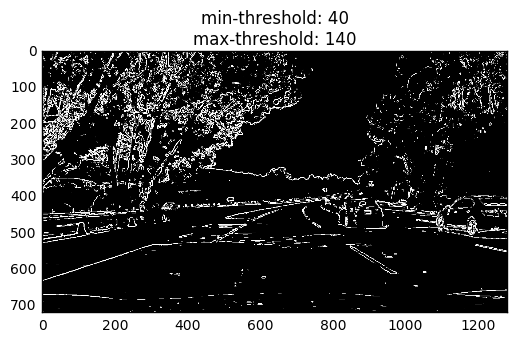

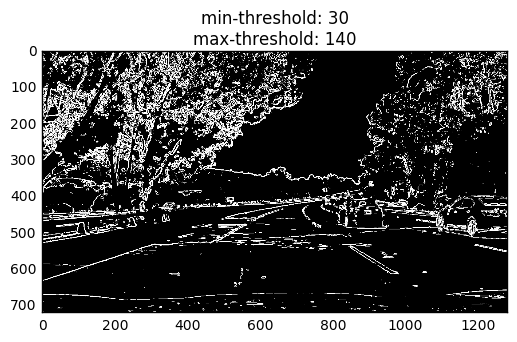

In [8]:
for thresh in [(50, 100), (30, 105), (40, 140), (30, 140)]:
  fig = plt.figure()
  start = thresh[0]
  end = thresh[1]
  plt.title("min-threshold: {}\nmax-threshold: {}".format(start, end))
  plt.imshow(mag_thresh(image, sobel_kernel=ksize, mag_thresh=(start, end)), cmap='gray')
plt.show()

# best 30 -140

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


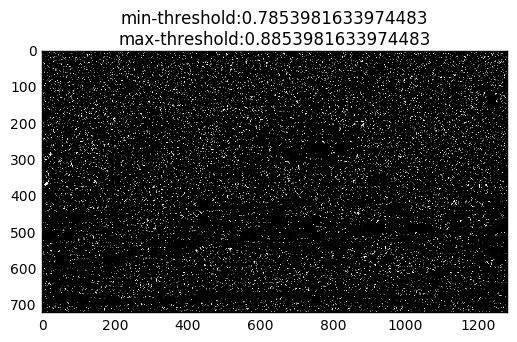

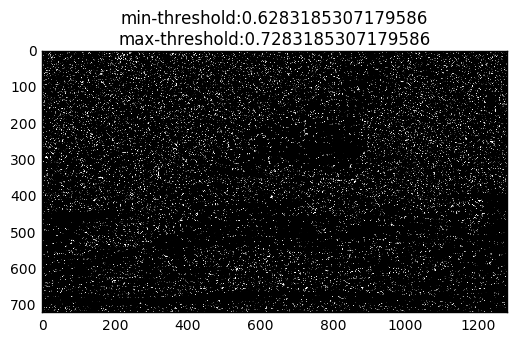

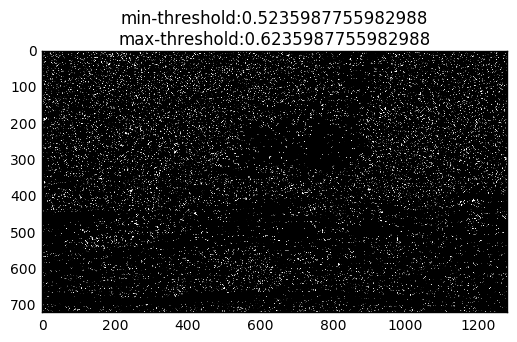

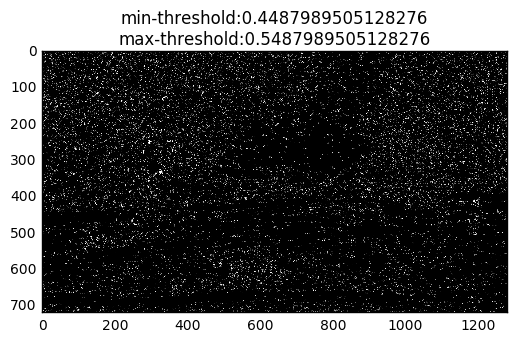

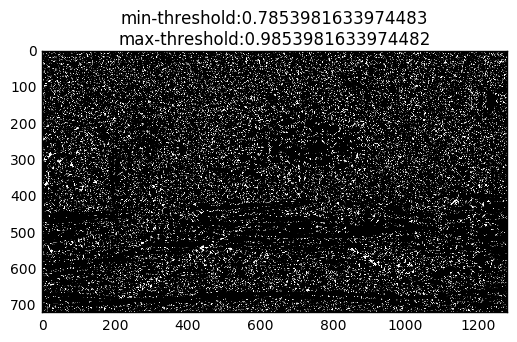

...

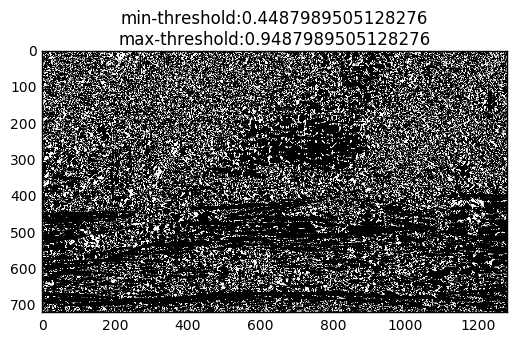

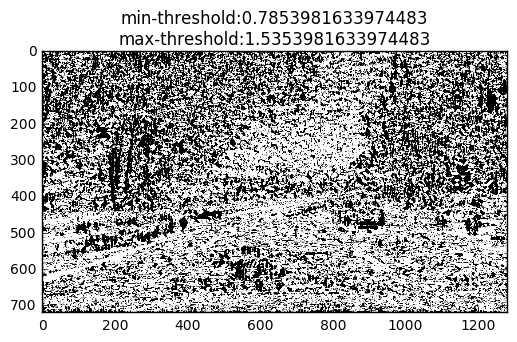

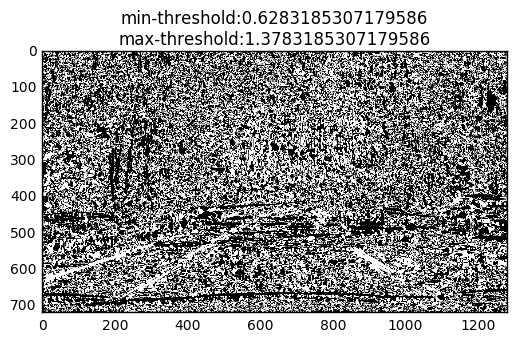

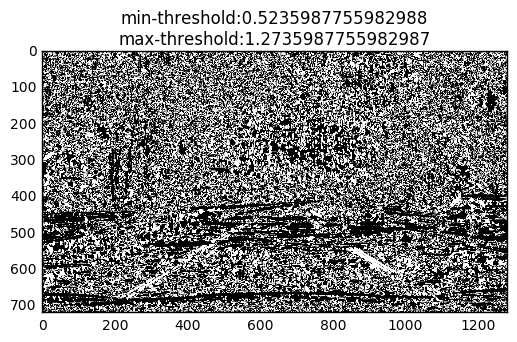

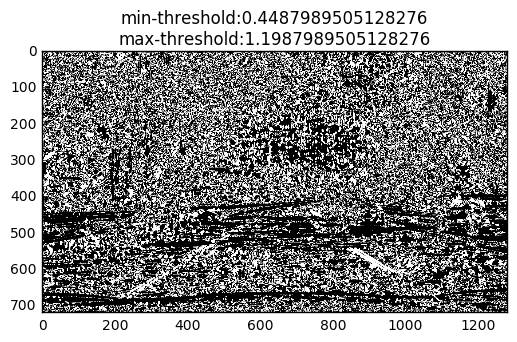

In [9]:
max_val = np.pi/2
for gap in [.1, .2, .3, .4, .5, .75]:
  for start in [np.pi/i for i in range(4, 8)]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("min-threshold:{}\nmax-threshold:{}".format(start, end))
    plt.imshow(dir_threshold(image, sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
    
plt.show()

Best Results:
- 0.78, 1.085
- 0.78 - 1.185
- 0.52 - 1.27

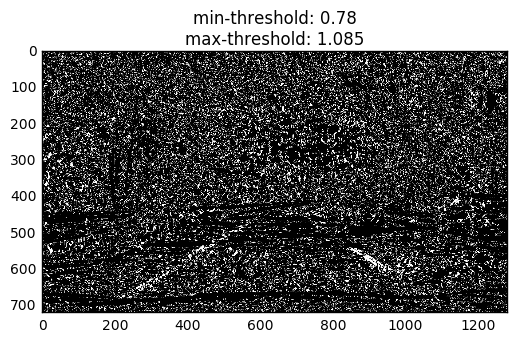

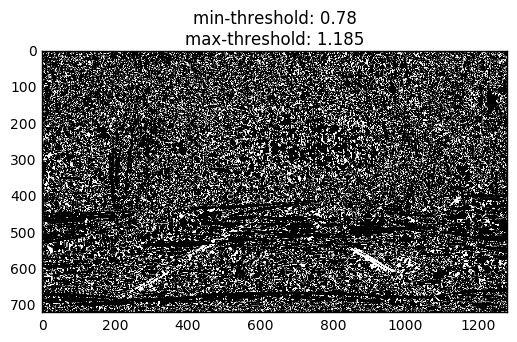

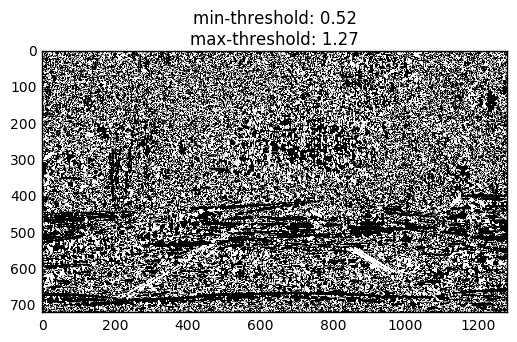

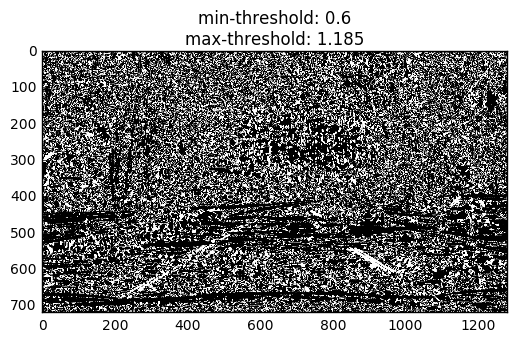

In [10]:
for thresh in [(0.78, 1.085), (.78, 1.185), (0.52, 1.27), (0.60, 1.185)]:
  fig = plt.figure()
  start = thresh[0]
  end = thresh[1]
  plt.title("min-threshold: {}\nmax-threshold: {}".format(start, end))
  plt.imshow(dir_threshold(image, sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
plt.show()

0.6 - 1.185

In [11]:
gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(30, 140))
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 140))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.75, 1.185))

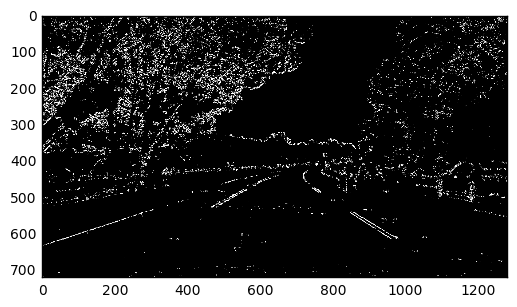

In [12]:
combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
plt.imshow(combined, cmap='gray')
plt.show()

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


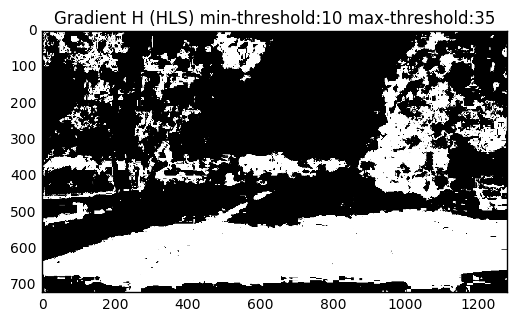

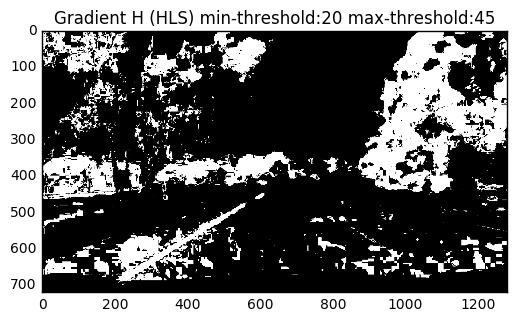

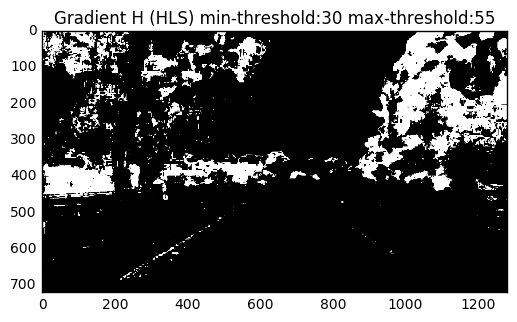

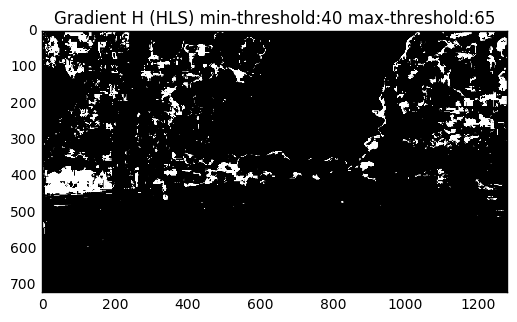

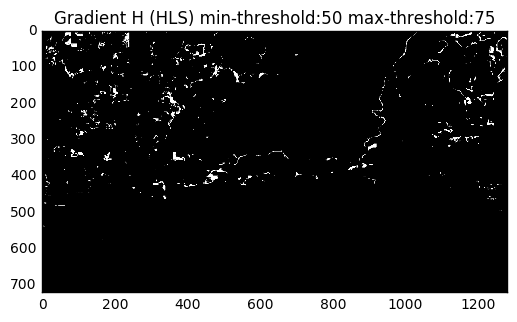

...

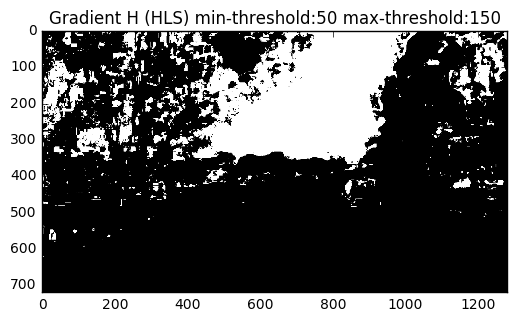

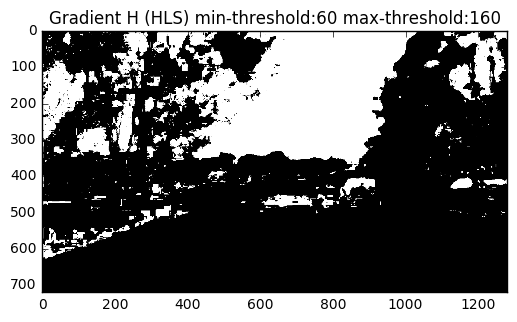

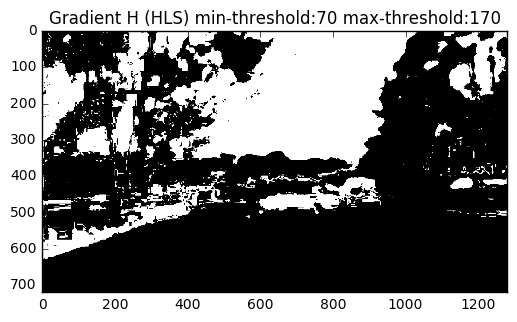

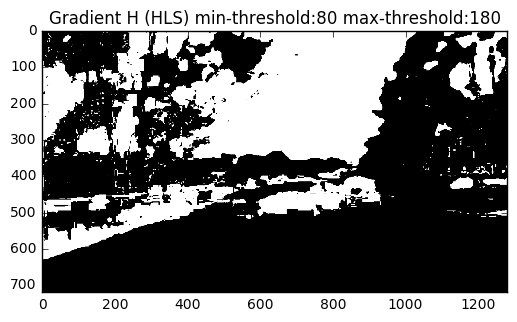

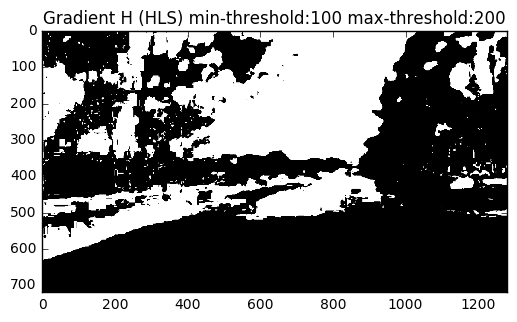

In [13]:
import math
max_val = 255
for gap in [25, 50, 75, 100]:
  for start in [10, 20, 30, 40, 50, 60, 70, 80, 100]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("Gradient H (HLS) min-threshold:{} max-threshold:{}".format(start, end))
    plt.imshow(hls_threshold(image, channel='h', thresh=(start, end)), cmap='gray')
    
plt.show()

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


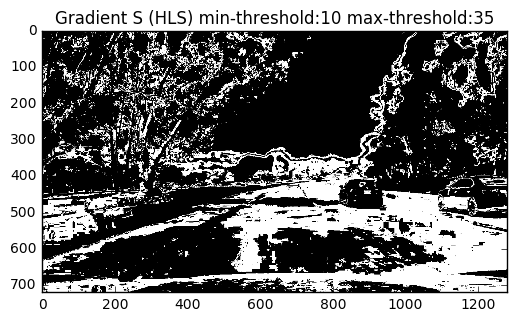

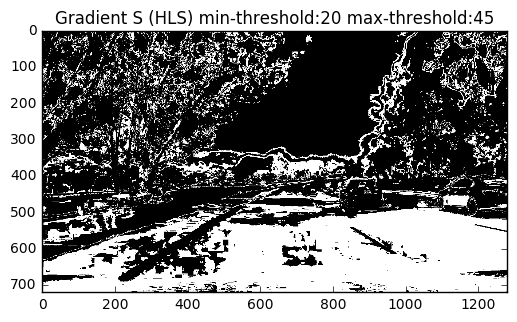

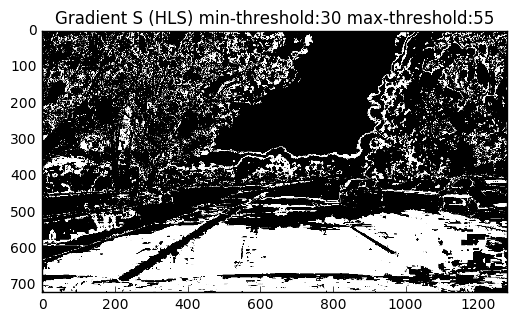

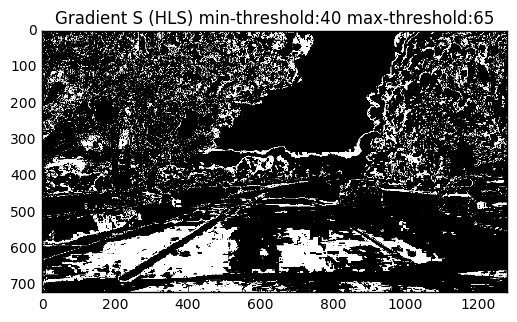

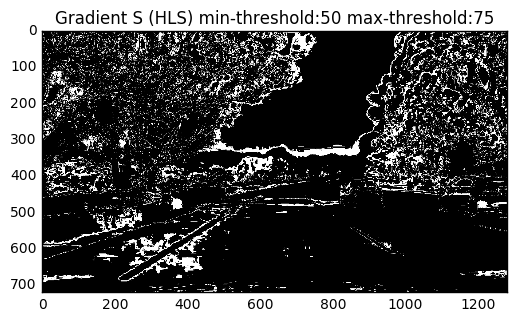

...

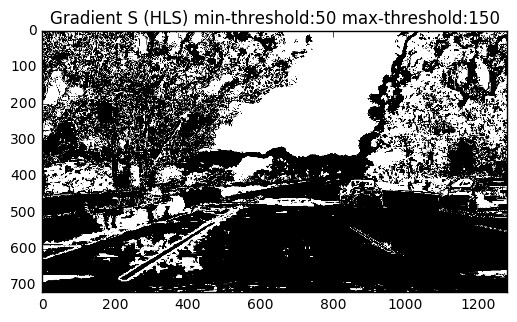

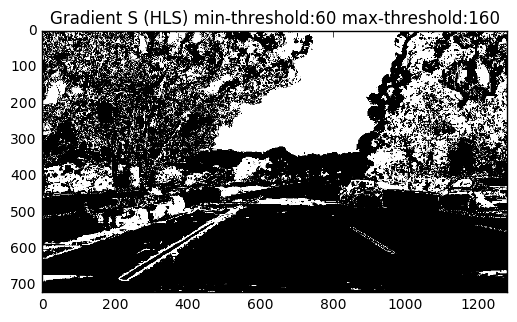

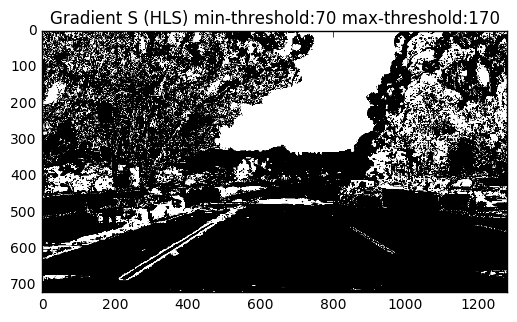

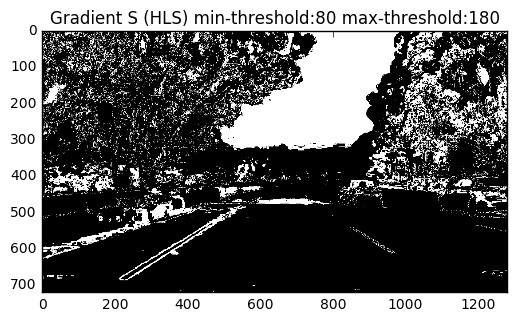

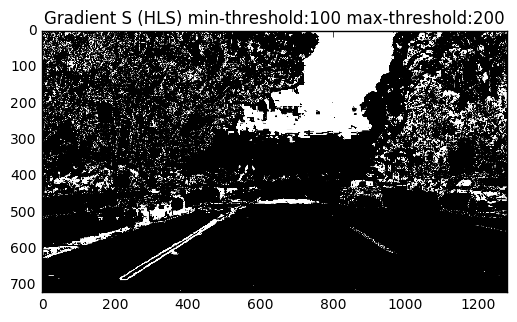

In [14]:
import math
max_val = 255
for gap in [25, 50, 75, 100]:
  for start in [10, 20, 30, 40, 50, 60, 70, 80, 100]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("Gradient S (HLS) min-threshold:{} max-threshold:{}".format(start, end))
    plt.imshow(hls_threshold(image, channel='s', thresh=(start, end)), cmap='gray')
    
plt.show()
# v = cv2.cvtColor(image, cv2.COLOR_RGB2HLS).astype(np.float)[:,:,2]
# print(v)
# binary = np.zeros_like(v)
# binary[(v >= 0) & (v <= 255)] = 255

# plt.imshow(binary, cmap='gray')
# plt.show()

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


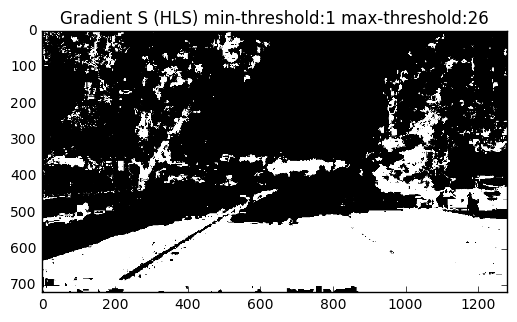

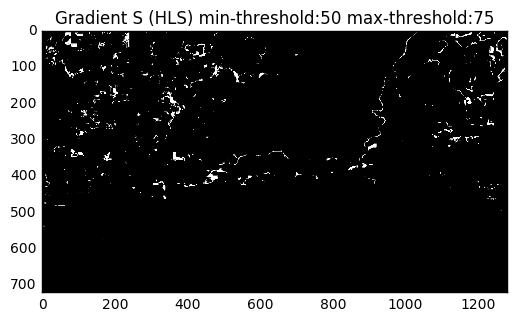

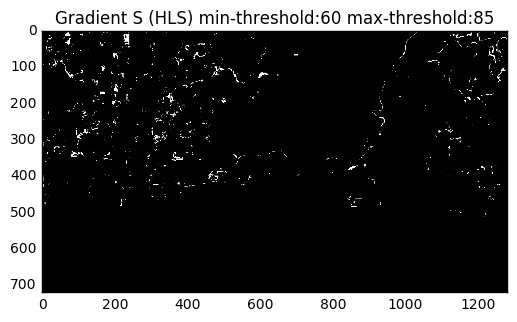

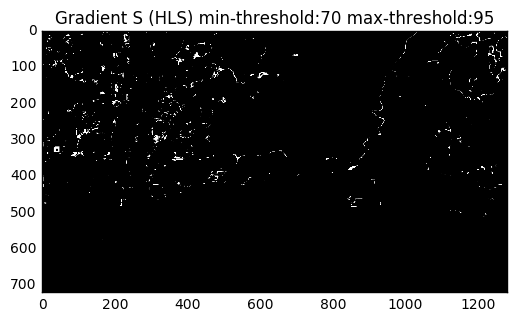

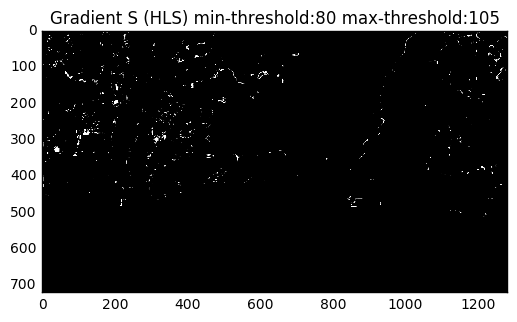

...

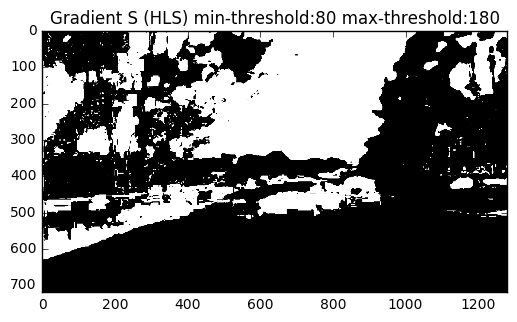

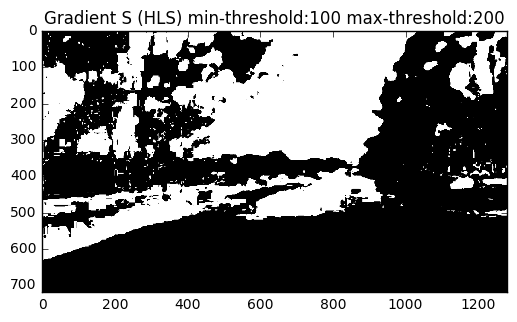

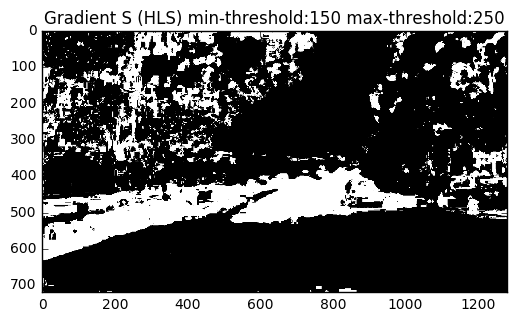

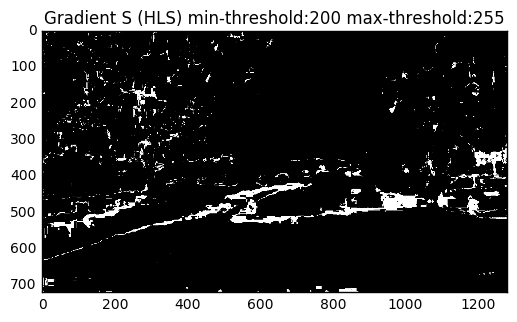

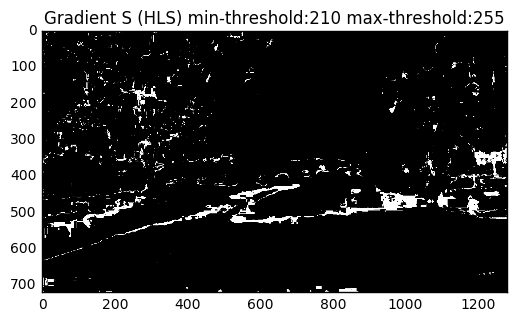

In [21]:
import math
max_val = 255
for gap in [25, 50, 75, 100]:
  for start in [1, 50, 60, 70, 80, 100, 150, 200, 210]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("Gradient S (HLS) min-threshold:{} max-threshold:{}".format(start, end))
    plt.imshow(hls_threshold(image, channel='h', thresh=(start, end)), cmap='gray')
    
plt.show()

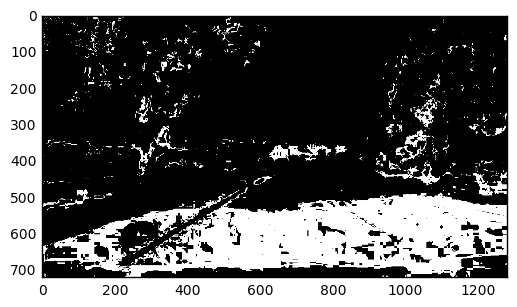

In [26]:
plt.imshow(hls_threshold(image, channel='h', thresh=(10, 20)), cmap='gray')
plt.show()

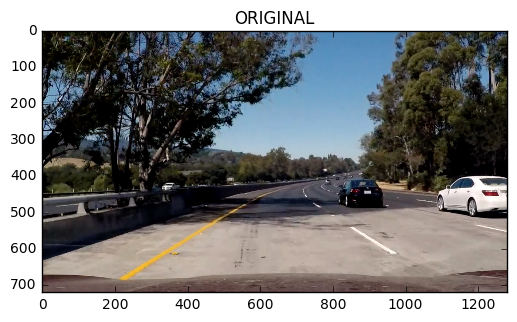

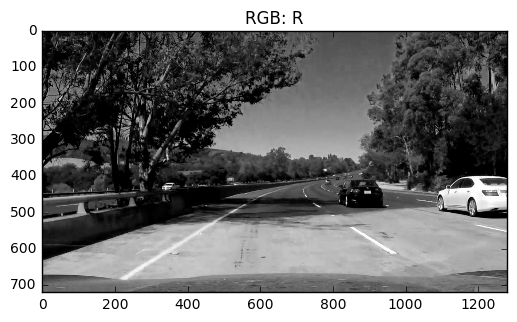

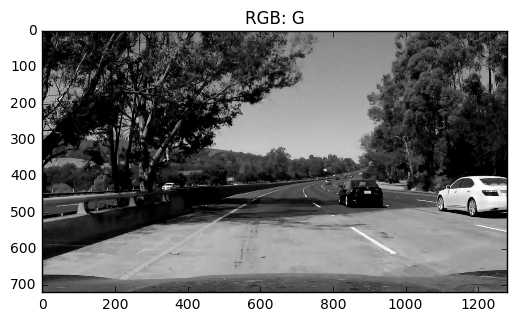

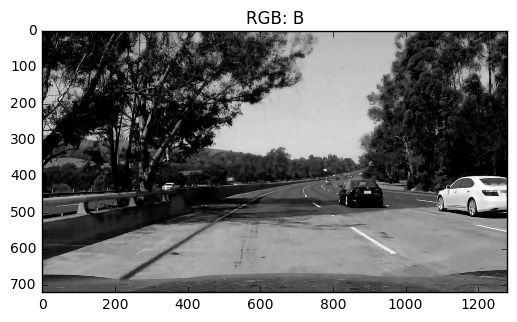

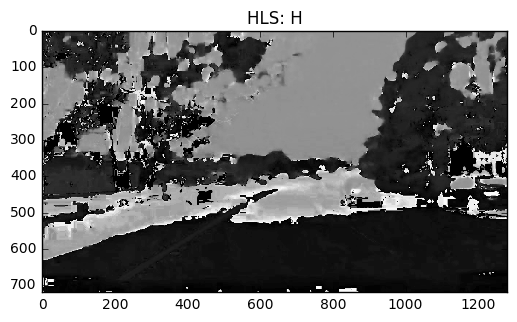

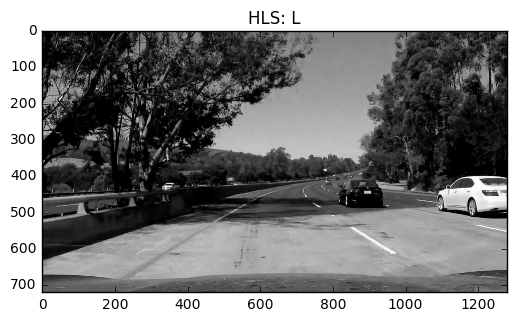

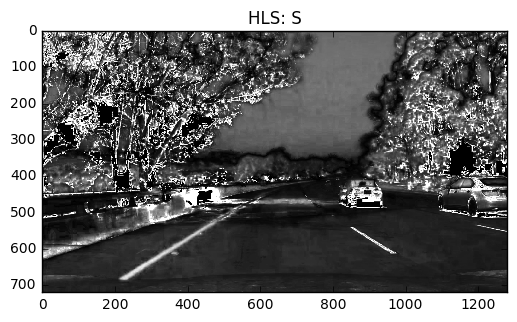

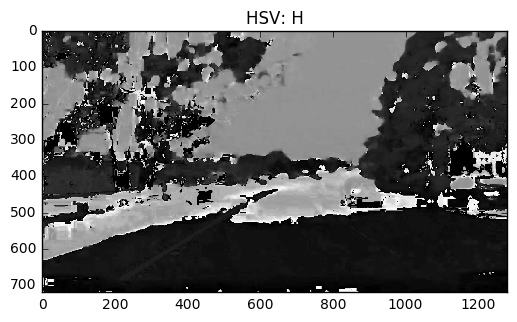

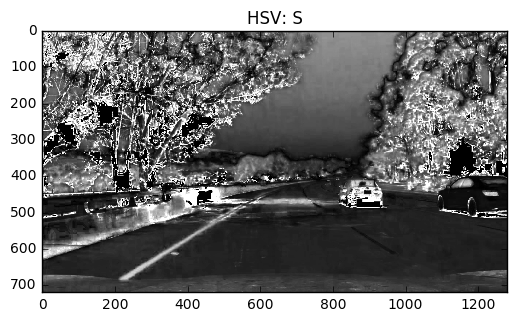

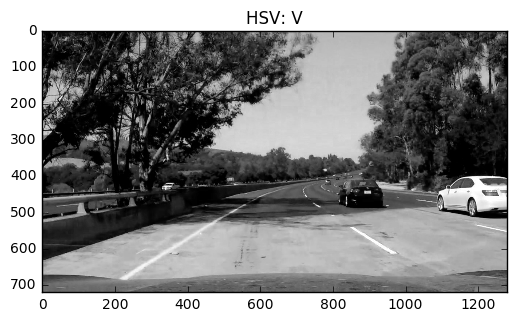

In [63]:
image = mpimg.imread('test_images/test5.jpg')

fig = plt.figure()
plt.title("ORIGINAL")
plt.imshow(image)
fig = plt.figure()
plt.title("RGB: R")
plt.imshow(image[:,:,0], cmap='gray')
fig = plt.figure()
plt.title("RGB: G")
plt.imshow(image[:,:,1], cmap='gray')
fig = plt.figure()
plt.title("RGB: B")
plt.imshow(image[:,:,2], cmap='gray')

hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS).astype(np.float)
fig = plt.figure()
plt.title("HLS: H")
plt.imshow(hls[:,:,0], cmap='gray')
fig = plt.figure()
plt.title("HLS: L")
plt.imshow(hls[:,:,1], cmap='gray')
fig = plt.figure()
plt.title("HLS: S")
plt.imshow(hls[:,:,2], cmap='gray')

hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV).astype(np.float)
fig = plt.figure()
plt.title("HSV: H")
plt.imshow(hsv[:,:,0], cmap='gray')
fig = plt.figure()
plt.title("HSV: S")
plt.imshow(hsv[:,:,1], cmap='gray')
fig = plt.figure()
plt.title("HSV: V")
plt.imshow(hsv[:,:,2], cmap='gray')
plt.show()

/Users/kyledorman/anaconda/envs/carnd/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


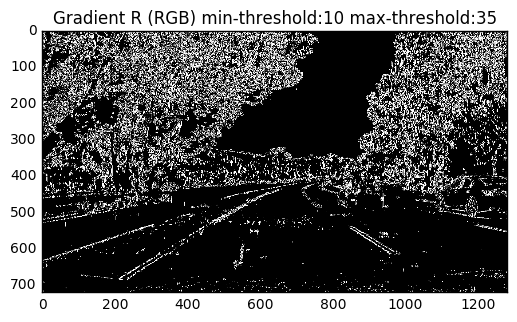

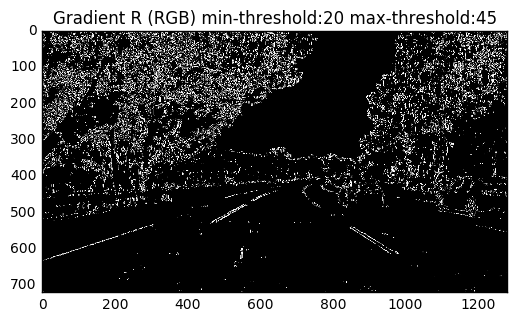

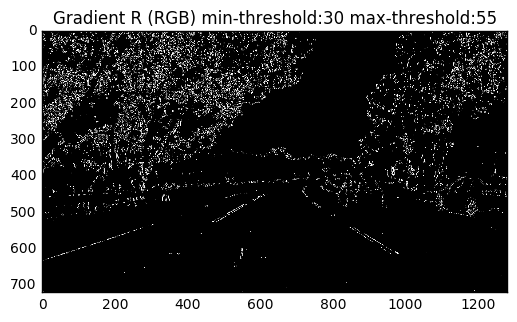

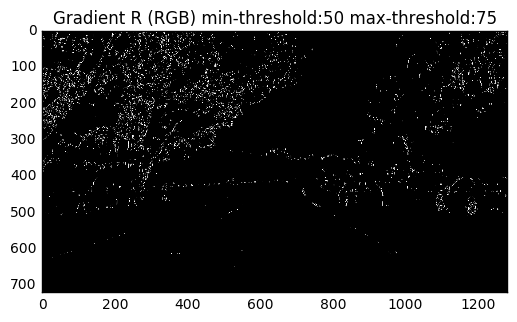

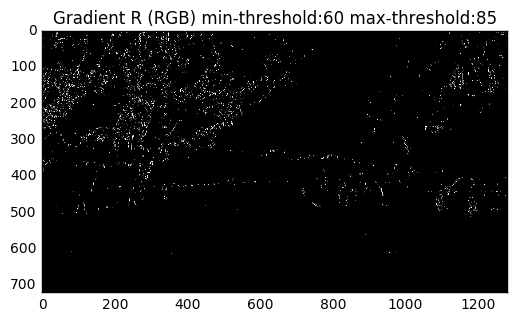

...

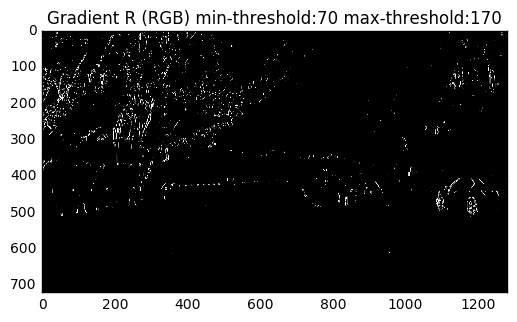

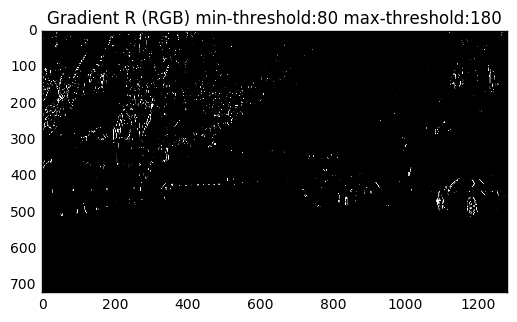

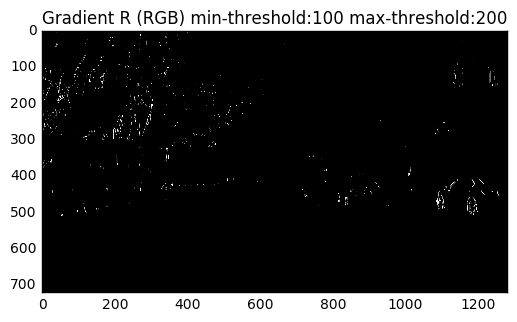

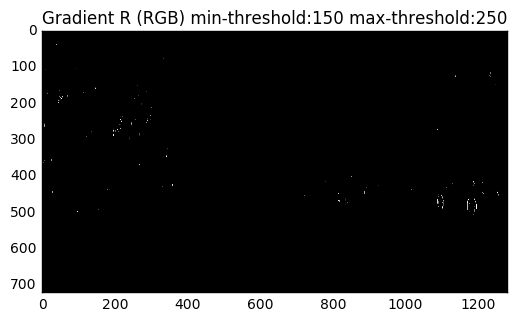

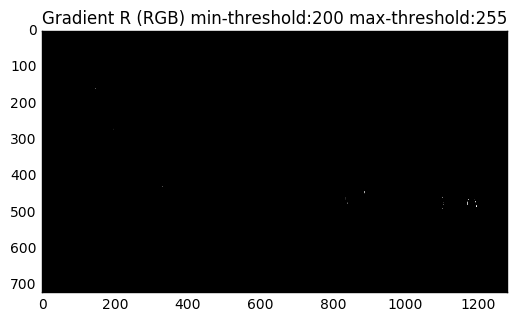

In [39]:
max_val = 255
for gap in [25, 50, 75, 100]:
  for start in [10, 20, 30, 50, 60, 70, 80, 100, 150, 200]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("Gradient R (RGB) min-threshold:{} max-threshold:{}".format(start, end))
    plt.imshow(abs_channel_sobel_thresh(image, channel=0, orient='x', sobel_kernel=ksize, thresh=(start, end)), cmap='gray')
    
plt.show()

Best: 10 - 35

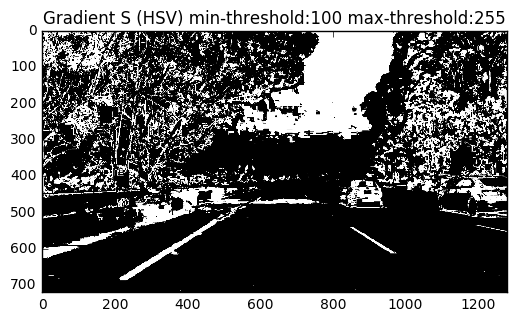

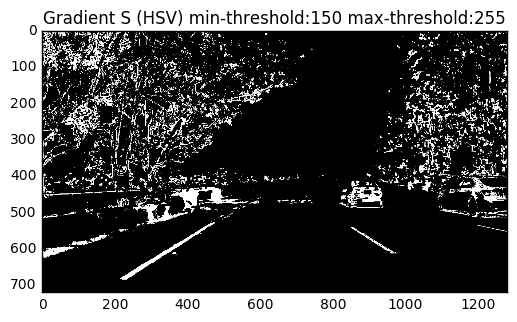

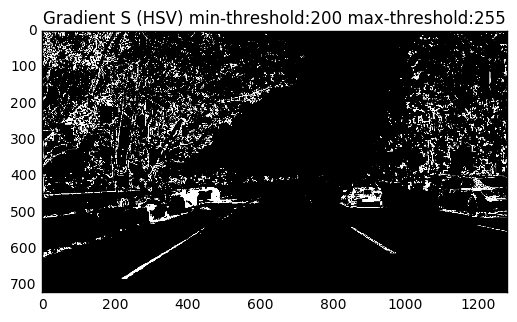

In [62]:
max_val = 255
image = mpimg.imread('test_images/test5.jpg')
for gap in [155]:
  for start in [100, 150, 200]:
    end = min(start + gap, max_val)
    fig = plt.figure()
    plt.title("Gradient S (HSV) min-threshold:{} max-threshold:{}".format(start, end))
    plt.imshow(hls_threshold(image, channel='s', thresh=(start, end)), cmap='gray')
    
plt.show()

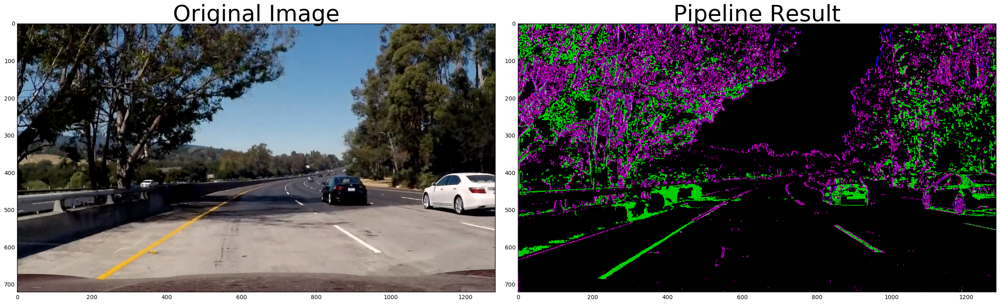

In [30]:
# image = mpimg.imread('bridge_shadow.jpg')
def abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(0, 255)):
  if orient is 'x':
      sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
  else:
      sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
  abs_sobel = np.absolute(sobel)
  scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
  grad_binary = np.zeros_like(scaled_sobel)
  grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 50
  return grad_binary

# Edit this function to create your own pipeline.
def pipeline(rgb, s_thresh=(170, 255), lx_thresh=(20, 100), rx_thresh=(20, 100), vx_thresh=(20, 120)):
    rgb = np.copy(rgb)
    # Convert to HSV color space and separate the V channel
    hls = cv2.cvtColor(rgb, cv2.COLOR_RGB2HLS).astype(np.float)
    hsv = cv2.cvtColor(rgb, cv2.COLOR_RGB2HSV).astype(np.float)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    r_channel = rgb[:,:,0]
    v_channel = hsv[:,:,2]
    
    # Sobel x l
    lx = abs_sobel_thresh(l_channel, sobel_kernel=11, thresh=lx_thresh)
    
    # Sobel x r
    rx = abs_sobel_thresh(r_channel, sobel_kernel=11, thresh=rx_thresh)
    
    # Sobel x v
    vx = abs_sobel_thresh(v_channel, sobel_kernel=11, thresh=vx_thresh)
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 50
    color_binary = np.dstack((rx, s_binary, vx))
    return color_binary
    
result = pipeline(image)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(result)
ax2.set_title('Pipeline Result', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

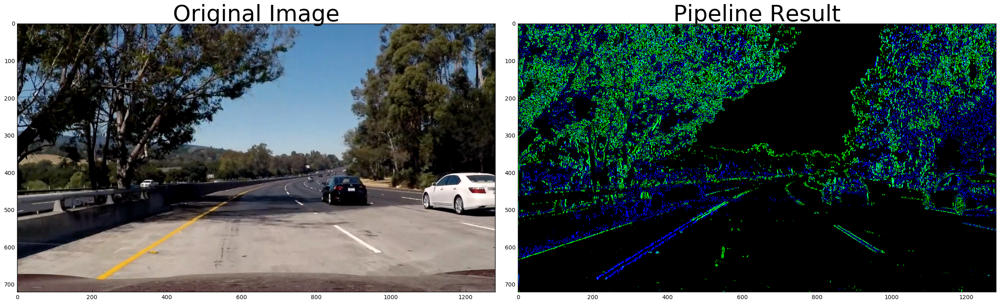

In [66]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


image = mpimg.imread('test_images/test5.jpg')

def sobel_x_abs(img, thresh):
    img = np.copy(img)
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return sxbinary
  
def abs_channel_sobel_thresh(img, channel=0, orient='x', sobel_kernel=3, thresh=(0, 255)):
  c_img = img[:,:,channel]
  if orient is 'x':
      sobel = cv2.Sobel(c_img, cv2.CV_64F, 1, 0)
  else:
      sobel = cv2.Sobel(c_img, cv2.CV_64F, 0, 1)
  abs_sobel = np.absolute(sobel)
  scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
  grad_binary = np.zeros_like(scaled_sobel)
  grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
  return grad_binary
    
def s_binary(img, thresh):
    # Threshold color channel
    s_binary = np.zeros_like(img)
    s_binary[(img >= thresh[0]) & (img <= thresh[1])] = 1
    return s_binary

# Edit this function to create your own pipeline.
def pipeline(img, s_thresh=(20, 45), sx_thresh=(20, 55)):
    img = np.copy(img)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    
    vx = abs_channel_sobel_thresh(hsv, channel = 2, thresh=sx_thresh)
    lx = abs_channel_sobel_thresh(hls, channel = 1, thresh=sx_thresh)
    rx = abs_channel_sobel_thresh(img, channel = 0, thresh=sx_thresh)
    sx = abs_channel_sobel_thresh(hls, channel = 2, thresh=(20, 45))
    
#     s_calc = s_binary(s_channel, s_thresh)
    
    comb_vlr = np.zeros_like(rx)
    comb_vlr[((rx == 1) & (lx == 1)) | ((rx == 1) & (vx == 1)) | ((lx == 1) & (vx == 1))] = 255
    sx[sx==1] = 255

    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    color_binary = np.dstack(( np.zeros_like(rx), comb_vlr, sx))
    return color_binary
    
result = pipeline(image)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(result)
ax2.set_title('Pipeline Result', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

plt.show()

- Camera calabration
- Distortion correction
- color threshold 
- perspective transform 
